# Demos for Visualization Tools

## Visualize Image Matching

- SIFT+NN
- SP.+NN
- SP.+SG
- DISK+NN
- DISK+LG.
- LoFTR

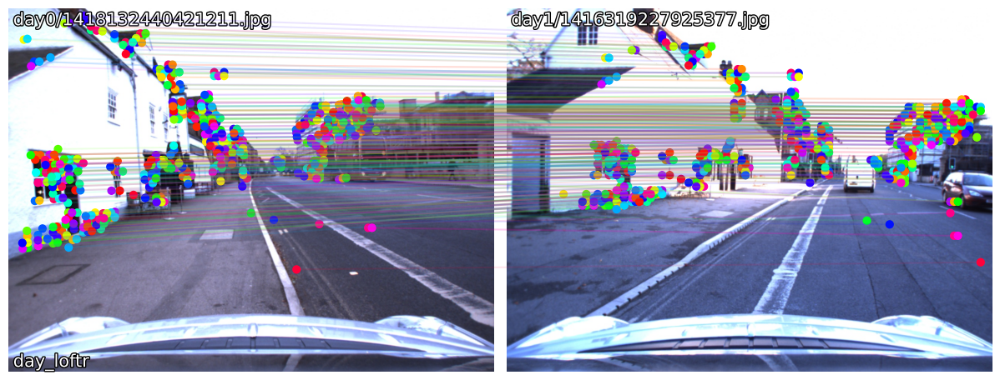

In [6]:
from pathlib import Path
from viz import plot_matches, draw_matches
from utils import plot_images, read_image

# An image pair in day sequence
database_image = Path('dataset/images/')
qImage = 'day0/1418132440421211.jpg'
rImage = 'day1/1416319227925377.jpg'
# SIFT+NN
feature_path = Path('dataset/features/day_loftr_kpts.h5')
match_path = Path('dataset/matches/day_loftr.h5')
# plot
# plot_images([read_image(database_image / qImage), read_image(database_image / rImage)])
draw_matches(match_path, feature_path, database_image, qImage, rImage)

## Inliers distribution

In [ ]:
# import anything
from viz import viz_inliers_distribution, find_image_pairs
from pathlib import Path
from matplotlib import pyplot as plt

In [ ]:
exp_logs = Path('dataset/exps/day_superpoint_max_superglue.npy')
viz_inliers_distribution(exp_logs)
plt.show()

### Use can use customized bins for better visualization

In [ ]:
exp_logs = Path('dataset/exps/night_superpoint_max_superglue.npy')
# bins = [0, 0.005, 0.01, 0.02, 0.025]
viz_inliers_distribution(exp_logs, bins=None)
plt.show()

In [ ]:
exp_logs = Path('dataset/exps/season_superpoint_max_superglue.npy')
# bins = [0, 0.005, 0.01, 0.02, 0.025]
viz_inliers_distribution(exp_logs, bins=None)
plt.show()

In [ ]:
exp_logs = Path('dataset/exps/weather_superpoint_max_superglue.npy')
# bins = [0, 0.005, 0.01, 0.02, 0.025]
viz_inliers_distribution(exp_logs, bins=None)
plt.show()

### Plot distribution of methods in Day sequence

In [ ]:
exp_logs = ['dataset/exps/day_sift_NN.npy', 'dataset/exps/day_superpoint_max_NN.npy', 'dataset/exps/day_disk_NN.npy',
           'dataset/exps/day_disk_lightglue.npy', 'dataset/exps/day_loftr.npy']
exp_logs_path = [Path(exp_log) for exp_log in exp_logs]
for exp_logs_path in exp_logs_path:
      viz_inliers_distribution(exp_logs_path, bins=None)
      plt.show()

### Plot for Night Sequences

In [ ]:
exp_logs = ['dataset/exps/night_sift_NN.npy', 
            'dataset/exps/night_superpoint_max_NN.npy', 
            'dataset/exps/night_disk_NN.npy',
           'dataset/exps/night_disk_lightglue.npy', 
           'dataset/exps/night_loftr.npy']
exp_logs_path = [Path(exp_log) for exp_log in exp_logs]
for exp_logs_path in exp_logs_path:
      viz_inliers_distribution(exp_logs_path, bins=None)
      plt.show()

## False Positive Analysis and False Negative Analysis

- Analyze SuperPoint+SuperGlue in Night sequence

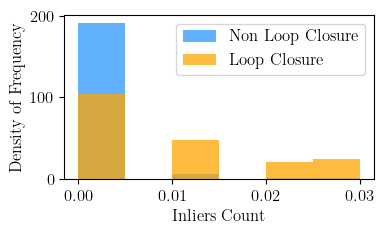

In [1]:
from viz import viz_inliers_distribution, find_image_pairs, plot_matches_pair
from pathlib import Path
from matplotlib import pyplot as plt
from utils import compute_distance, get_poses
import numpy as np

# exp_log
exp_log = Path('dataset/exps/night_superpoint_max_superglue.npy')
# draw inliers distribution with customized bins
bins = [0, 0.005, 0.01, 0.015, 0.02, 0.025, 0.03] # night_superpoint_max_superglue
# bins = [0, 0.01, 0.02, 0.03, 0.05] # day_superpoint_max_superglue
viz_inliers_distribution(exp_log, bins=bins)
plt.show()

- Visualize the image matching of positive pairs of 0-0.005 and negative pairs of 0.01-0.015.

In [2]:
# false negatives [0-0.005]
idx, qImages, rImages, probs = find_image_pairs(exp_log, [0, 0.05], 1)
# save as numpy array, concatenate all pairs

q_ins_file = 'dataset/gps/day0/interpolate_poses.csv'
r_ins_file = 'dataset/gps/night0/interpolate_poses.csv'

qTimestamp = [int(Path(qImage).stem) for qImage in qImages]
rTimestamp = [int(Path(rImage).stem) for rImage in rImages]

qTs, qPoses = get_poses(q_ins_file, qTimestamp)
rTs, rPoses = get_poses(r_ins_file, rTimestamp)

distances = [compute_distance(qPose, rPose) for qPose, rPose in zip(qPoses, rPoses)]


np.save('dataset/exps/night_superpoint_max_superglue_fn.npy', 
        {'idx': idx,
         'qImages': qImages,
         'rImages': rImages,
         'probs': probs,
         'distances': distances})

# random sample 10 pairs
# print(qImages, rImages, probs)
# idx = np.random.choice(len(idx), 10, replace=False)
# qImages = qImages[idx]
# rImages = rImages[idx]
# probs = probs[idx]

# visualize
# match_path = Path('dataset/matches/night_superpoint_max_superglue.h5')
# feature_path = Path('dataset/features/superpoint_max.h5')
# database_image = Path('dataset/images/')

# for qImage, rImage, prob in zip(qImages, rImages, probs):
#       plot_matches_pair(match_path, feature_path, database_image, qImage, rImage, 1, prob)



In [3]:

# false positive [0.01-0.015]
idx, qImages, rImages, probs = find_image_pairs(exp_log, [0.01, 0.015], 0)
q_ins_file = 'dataset/gps/day0/interpolate_poses.csv'
r_ins_file = 'dataset/gps/night0/interpolate_poses.csv'

qTimestamp = [int(Path(qImage).stem) for qImage in qImages]
rTimestamp = [int(Path(rImage).stem) for rImage in rImages]

qTs, qPoses = get_poses(q_ins_file, qTimestamp)
rTs, rPoses = get_poses(r_ins_file, rTimestamp)

distances = [compute_distance(qPose, rPose) for qPose, rPose in zip(qPoses, rPoses)]


# save as numpy array, concatenate all pairs
np.save('dataset/exps/night_superpoint_max_superglue_fp.npy', 
        {'idx': idx,
         'qImages': qImages,
         'rImages': rImages,
         'probs': probs,
         'distances': distances})

# random sample 10 pairs
# idx = np.random.choice(len(idx), 10, replace=False)

# qImages = qImages[idx]
# rImages = rImages[idx]
# probs = probs[idx]

# visualize
# match_path = Path('dataset/matches/night_superpoint_max_superglue.h5')
# feature_path = Path('dataset/features/superpoint_max.h5')
# database_image = Path('dataset/images/')
# for qImage, rImage, prob in zip(qImages, rImages, probs):
#       plot_matches_pair(match_path, feature_path, database_image, qImage, rImage, 1, prob)

### Statistics about the distance and viewpoint

In [ ]:
from utils import get_poses, compute_distance
import math

q_ins_file = 'dataset/gps/day0/interpolate_poses.csv'
r_ins_file = 'dataset/gps/night0/interpolate_poses.csv'

qTs, qPoses = get_poses(q_ins_file)
rTs, rPoses = get_poses(r_ins_file)
print(qTs)

qTimestamp = [int(Path(qImage).stem) for qImage in qImages]
rTimestamp = [int(Path(rImage).stem) for rImage in rImages]
# print(qTimestamp, rTimestamp)

# find the idx where qTimestamp in qTs, rTimestampe in rTs
qIdx = [qTs.index(qTime) for qTime in qTimestamp]
rIdx = [rTs.index(rTime) for rTime in rTimestamp]

# find the corresponding poses
qPoses = [qPoses[idx] for idx in qIdx]
rPoses = [rPoses[idx] for idx in rIdx]

# compute distance between qPoses and rPoses
# def compute_distance(qPose, rPose):
#       def rpy_to_quaternion(rpy):
#             roll, pitch, yaw = rpy
#             cy = np.cos(yaw * 0.5)
#             sy = np.sin(yaw * 0.5)
#             cp = np.cos(pitch * 0.5)
#             sp = np.sin(pitch * 0.5)
#             cr = np.cos(roll * 0.5)
#             sr = np.sin(roll * 0.5)

#             q = [
#                   cy * cp * cr + sy * sp * sr,
#                   cy * cp * sr - sy * sp * cr,
#                   sy * cp * sr + cy * sp * cr,
#                   sy * cp * cr - cy * sp * sr
#             ]
#             return q
      
#       def quaternion_angular_difference(q1, q2):
#             dot_product = np.dot(q1, q2)
#             # Ensure dot product is within bounds for acos
#             dot_product = np.clip(dot_product, -1.0, 1.0)
#             # Calculate the angle between the quaternions
#             angle = 2 * np.arccos(dot_product)
#             return angle
      
#       q1 = rpy_to_quaternion(qPose[3:])
#       q2 = rpy_to_quaternion(rPose[3:])
      
#       qPose = np.array(qPose)
#       rPose = np.array(rPose)
#       t = np.linalg.norm(qPose[:2] - rPose[:2])
#       r = quaternion_angular_difference(q1, q2)
#       return t, math.degrees(r)

distances = [compute_distance(qPose, rPose) for qPose, rPose in zip(qPoses, rPoses)]
print(distances)

# plot the distance
plt.figure()
plt.scatter(*zip(*distances))
plt.xlabel('Translation')
plt.ylabel('Rotation')
plt.show()






- Analyze in Day sequence

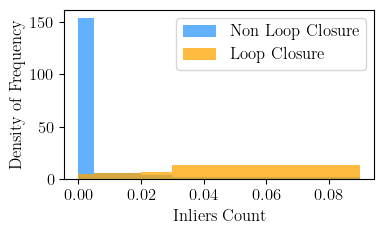

In [4]:
from viz import viz_inliers_distribution, find_image_pairs, plot_matches_pair
from pathlib import Path
from matplotlib import pyplot as plt
# exp_log
exp_log = Path('dataset/exps/day_superpoint_max_superglue.npy')
# draw inliers distribution with customized bins
# bins = [0, 0.005, 0.01, 0.015, 0.02, 0.025, 0.03] # night_superpoint_max_superglue
bins = [0, 0.005, 0.02, 0.03, 0.09] # day_superpoint_max_superglue
viz_inliers_distribution(exp_log, bins=bins)
plt.show()

- FP > 0.005, FN <0.02

- FP analysis

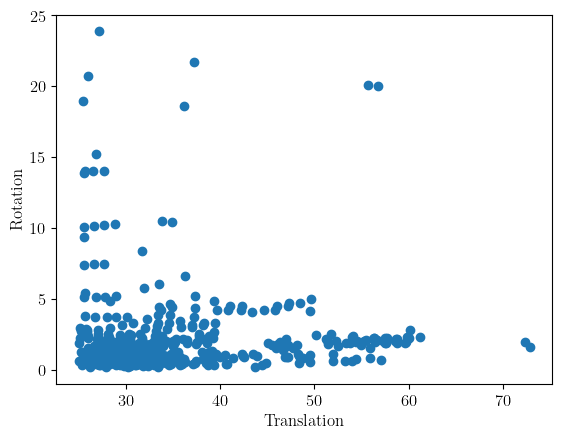

In [6]:
from viz import find_image_pairs, plot_matches_pair
from utils import compute_distance, get_poses
import numpy as np
from pathlib import Path

match_path = Path('dataset/exps/night_superpoint_max_superglue.npy')

# positive pairs [0-0.005]
idx, qImages, rImages, probs = find_image_pairs(exp_log, [0.05, 1], 0)
# save as numpy array, concatenate all pairs


q_ins_file = 'dataset/gps/day0/interpolate_poses.csv'
r_ins_file = 'dataset/gps/day1/interpolate_poses.csv'

qTs, qPoses = get_poses(q_ins_file)
rTs, rPoses = get_poses(r_ins_file)

qTimestamp = [int(Path(qImage).stem) for qImage in qImages]
rTimestamp = [int(Path(rImage).stem) for rImage in rImages]
# print(qTimestamp, rTimestamp)

# find the idx where qTimestamp in qTs, rTimestampe in rTs
qIdx = [qTs.index(qTime) for qTime in qTimestamp]
rIdx = [rTs.index(rTime) for rTime in rTimestamp]

# find the corresponding poses
qPoses = [qPoses[idx] for idx in qIdx]
rPoses = [rPoses[idx] for idx in rIdx]

distances = [compute_distance(qPose, rPose) for qPose, rPose in zip(qPoses, rPoses)]

np.save('dataset/exps/day_superpoint_max_superglue_fp.npy', 
        {'idx': idx,
         'qImages': qImages,
         'rImages': rImages,
         'probs': probs,
         'distances': distances})

# plot the distance
plt.figure()
plt.scatter(*zip(*distances))
plt.xlabel('Translation')
plt.ylabel('Rotation')
# plt.xlim(0, 30)
plt.show()

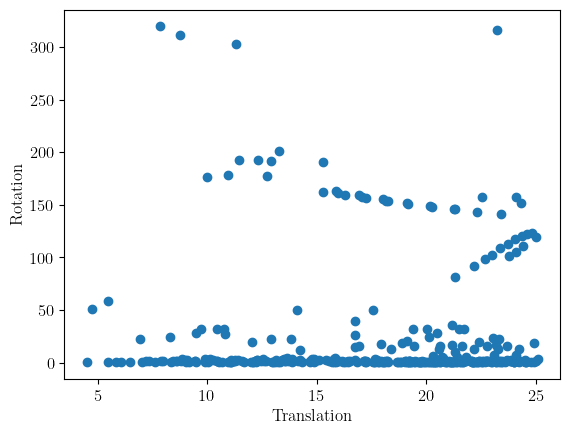

In [7]:
from viz import find_image_pairs, plot_matches_pair
import numpy as np

match_path = Path('dataset/exps/night_superpoint_max_superglue.npy')

# positive pairs [0-0.005]
idx, qImages, rImages, probs = find_image_pairs(exp_log, [0, 0.02], 1)
# save as numpy array, concatenate all pairs



q_ins_file = 'dataset/gps/day0/interpolate_poses.csv'
r_ins_file = 'dataset/gps/day1/interpolate_poses.csv'

qTs, qPoses = get_poses(q_ins_file)
rTs, rPoses = get_poses(r_ins_file)

qTimestamp = [int(Path(qImage).stem) for qImage in qImages]
rTimestamp = [int(Path(rImage).stem) for rImage in rImages]
# print(qTimestamp, rTimestamp)

# find the idx where qTimestamp in qTs, rTimestampe in rTs
qIdx = [qTs.index(qTime) for qTime in qTimestamp]
rIdx = [rTs.index(rTime) for rTime in rTimestamp]

# find the corresponding poses
qPoses = [qPoses[idx] for idx in qIdx]
rPoses = [rPoses[idx] for idx in rIdx]

distances = [compute_distance(qPose, rPose) for qPose, rPose in zip(qPoses, rPoses)]


np.save('dataset/exps/day_superpoint_max_superglue_fn.npy', 
        {'idx': idx,
         'qImages': qImages,
         'rImages': rImages,
         'probs': probs,
         'distances': distances})

# plot the distance
plt.figure()
plt.scatter(*zip(*distances))
plt.xlabel('Translation')
plt.ylabel('Rotation')
# plt.xlim(0, 30)
plt.show()

### Plot pairs from save npy

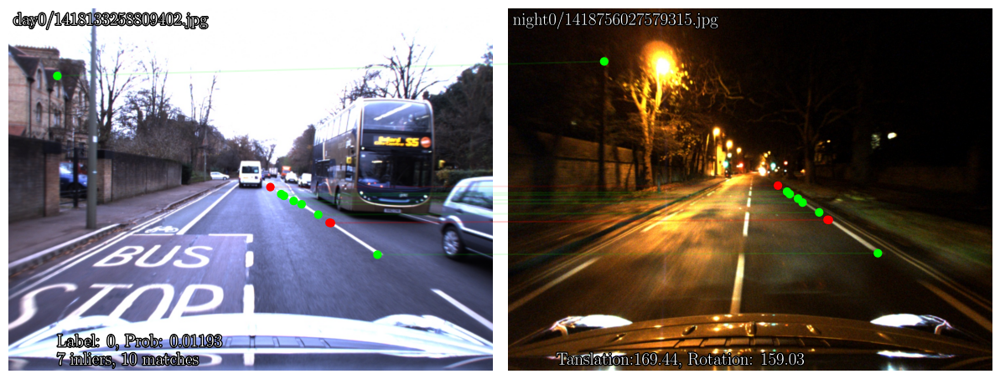

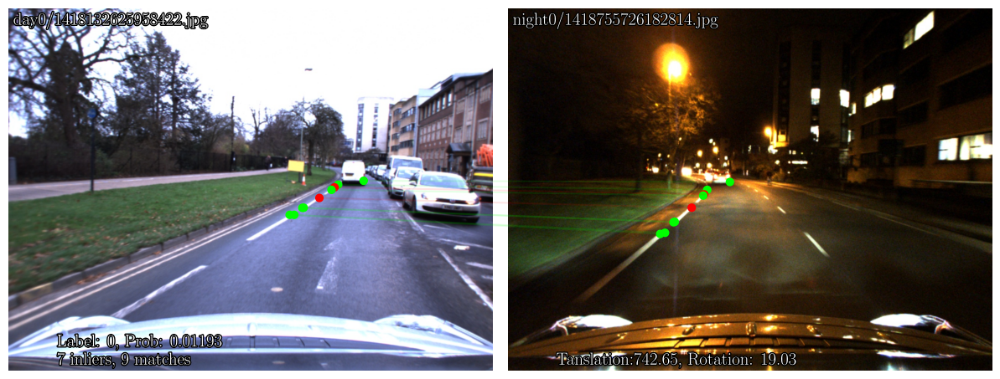

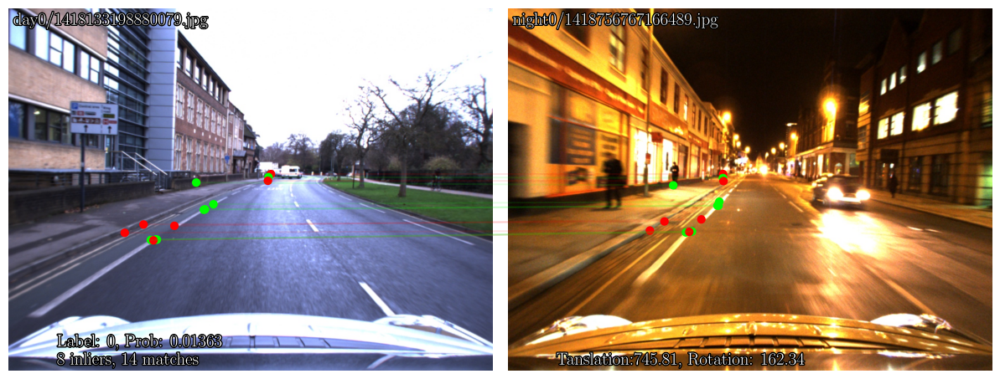

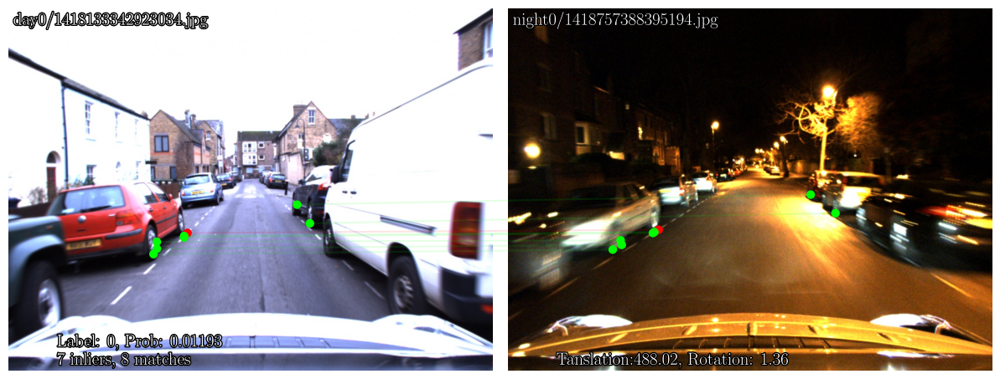

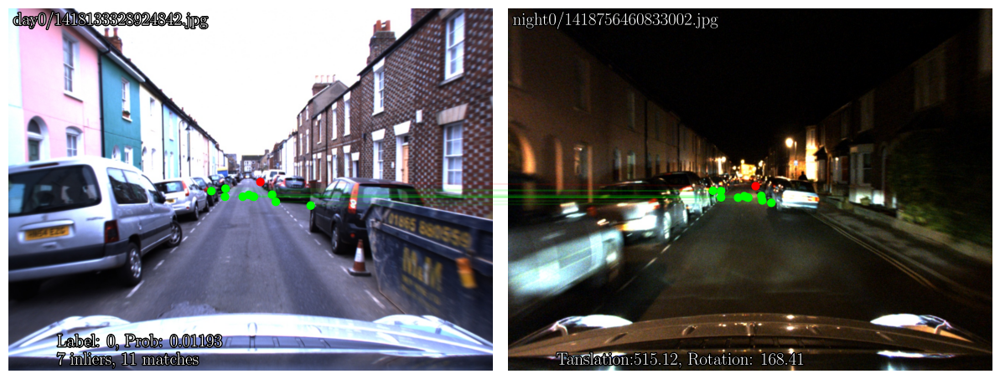

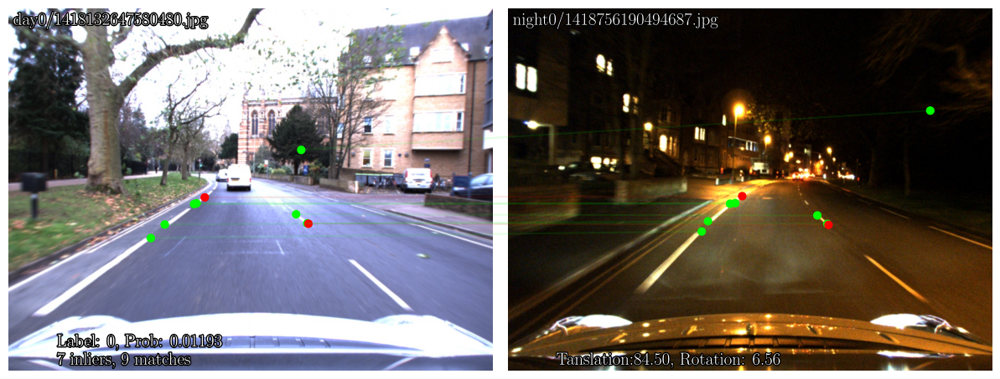

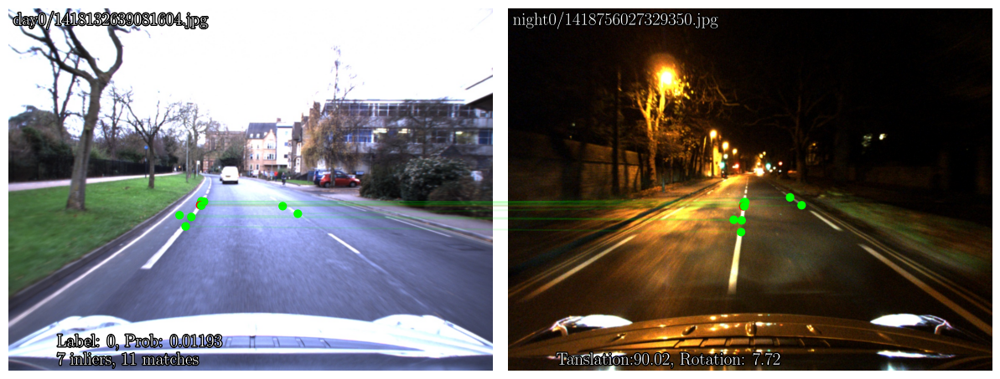

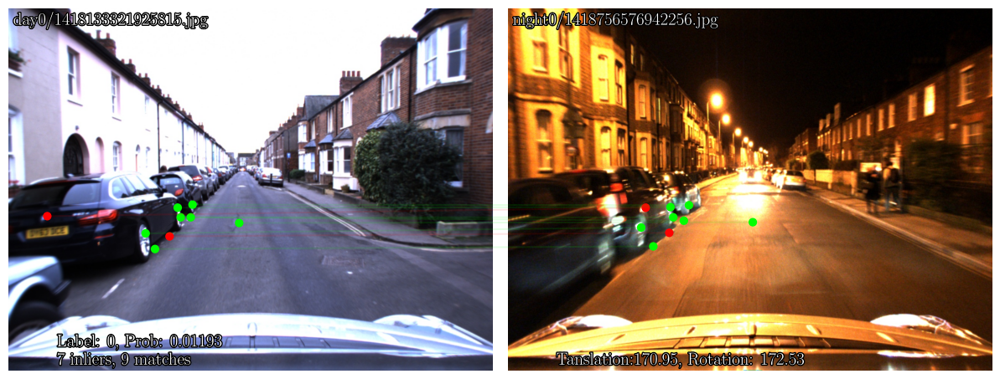

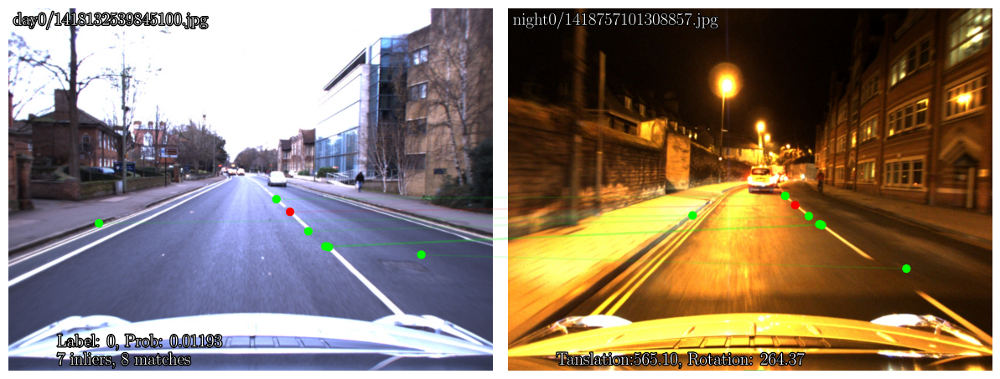

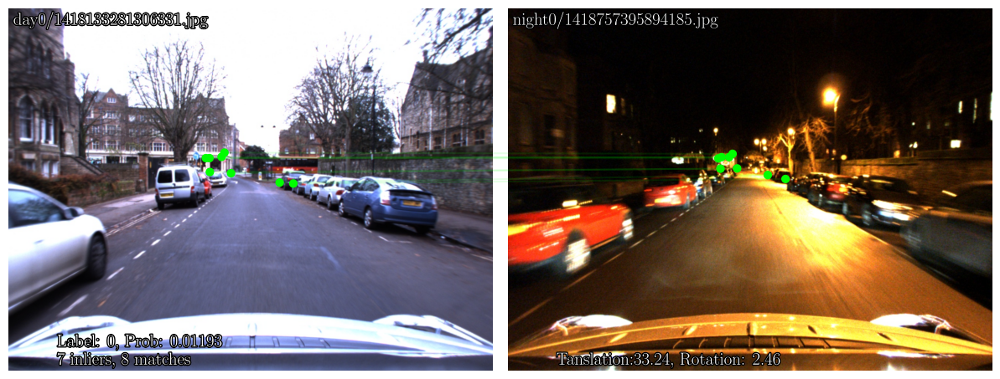

In [4]:
import numpy as np
from viz import plot_matches_pair
from pathlib import Path
from matplotlib import pyplot as plt

log = np.load('dataset/exps/night_superpoint_max_superglue_fp.npy', allow_pickle=True).tolist()
idx, qImages, rImages, probs, distances = log['idx'], log['qImages'], log['rImages'], log['probs'], log['distances']
match_path = Path('dataset/matches/night_superpoint_max_superglue.h5')
feature_path = Path('dataset/features/superpoint_max.h5')
database_image = Path('dataset/images/')
idx = np.random.choice(len(idx), 10, replace=False)
qImages = qImages[idx]
rImages = rImages[idx]
probs = probs[idx]


for qImage, rImage, prob, distance in zip(qImages, rImages, probs, distances):
      plot_matches_pair(match_path, feature_path, database_image, qImage, rImage, 0, prob, distance)
      plt.savefig(f'dataset/exps/night_fp_viz/{Path(qImage).stem}_{Path(rImage).stem}.png', bbox_inches='tight')
      plt.show()
      

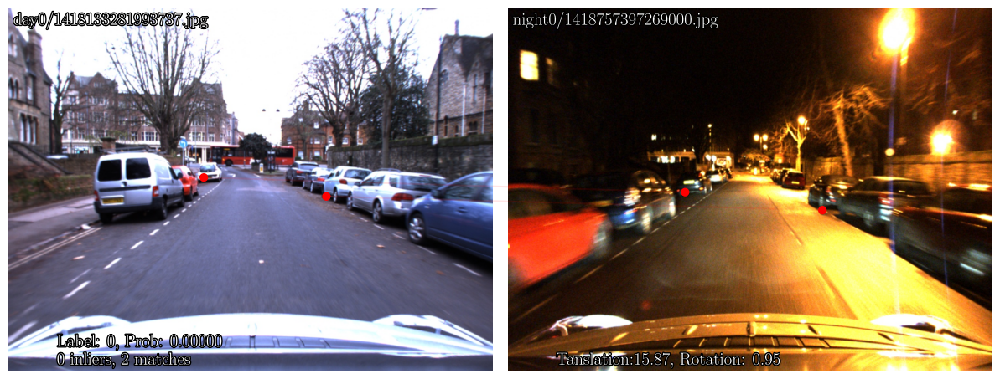

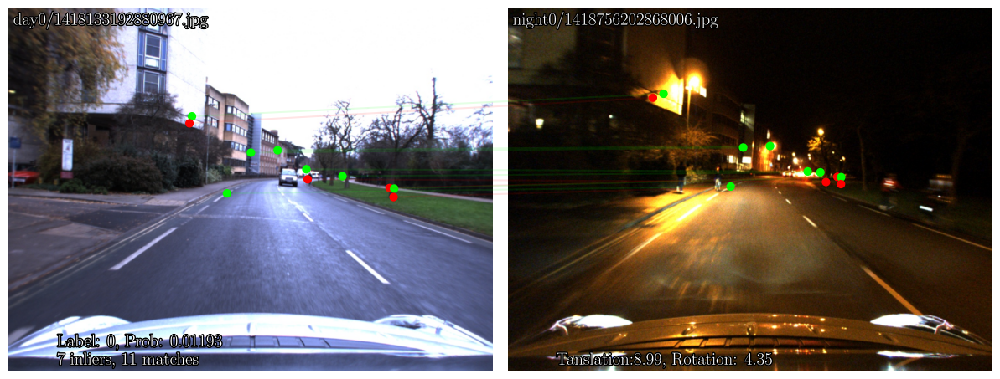

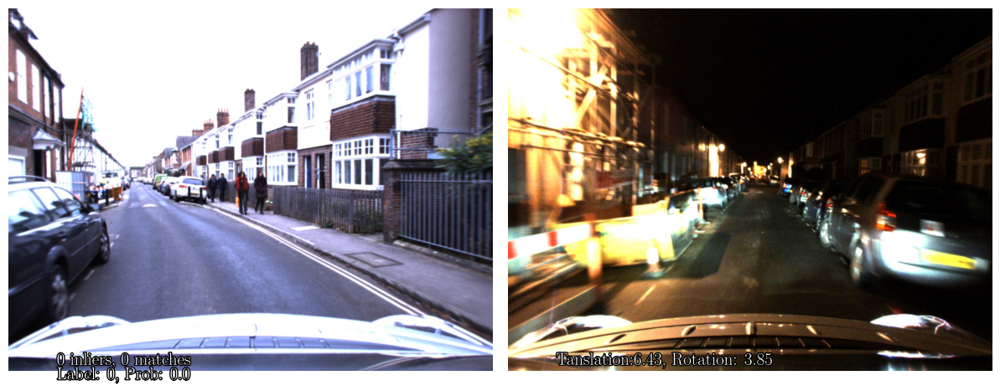

<Figure size 640x480 with 0 Axes>

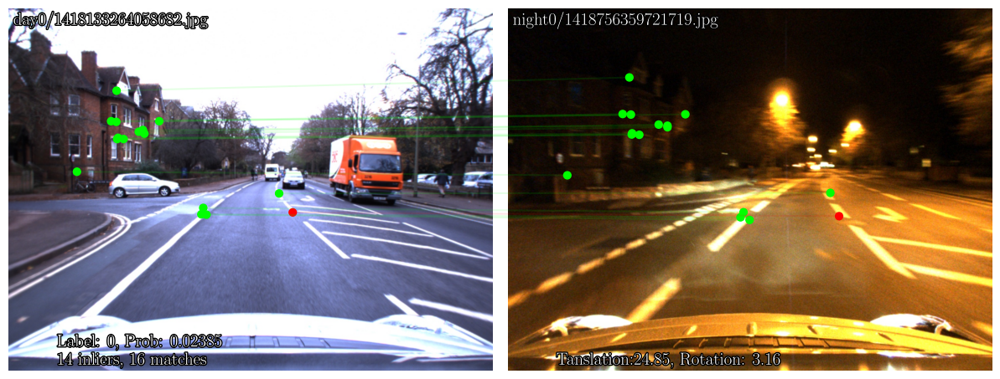

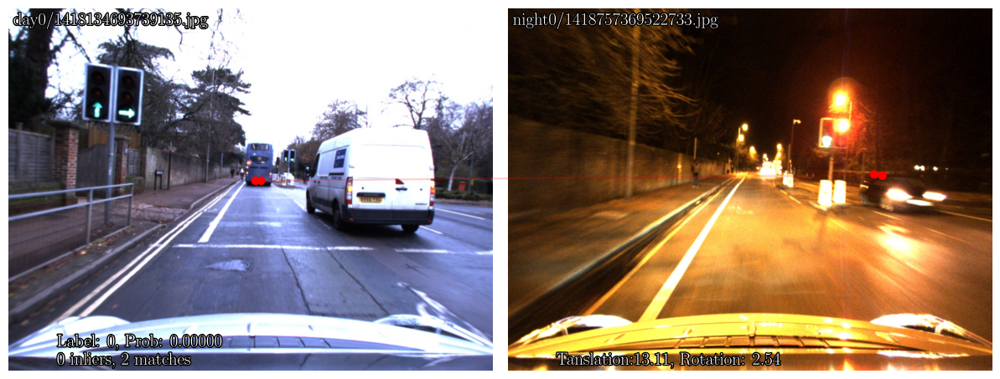

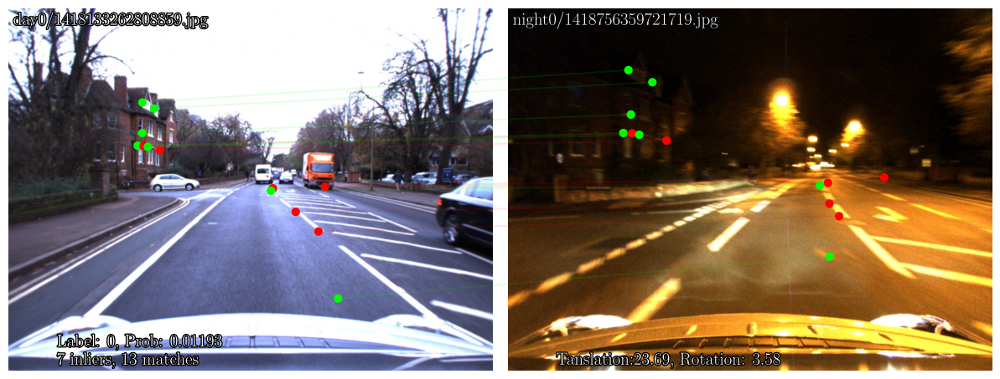

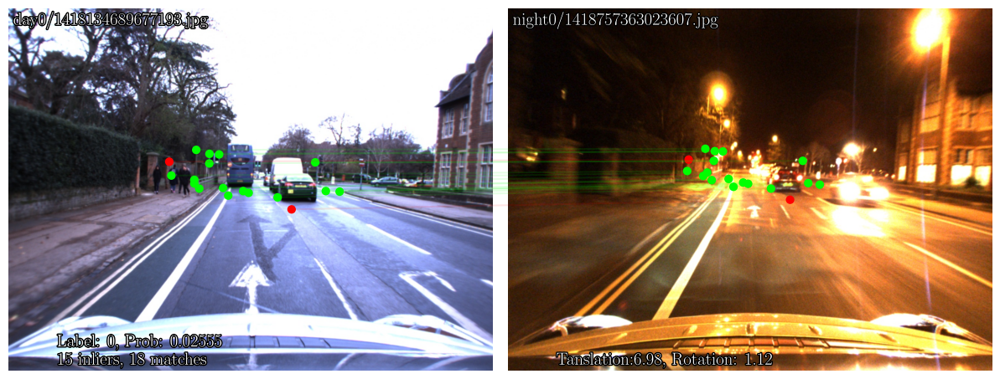

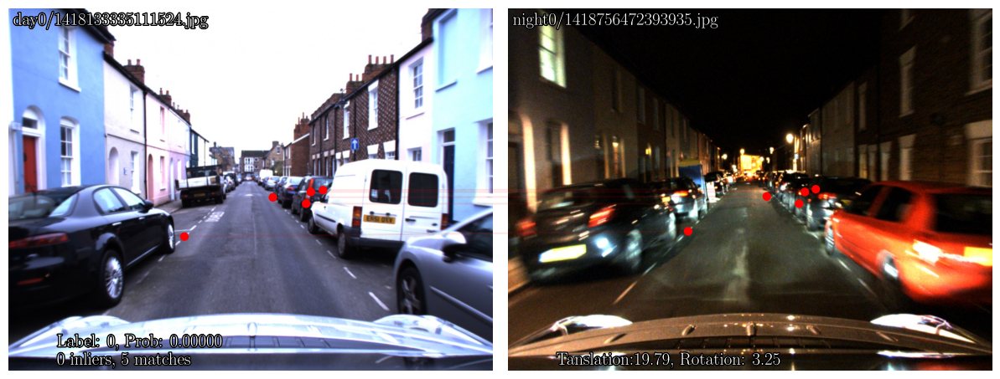

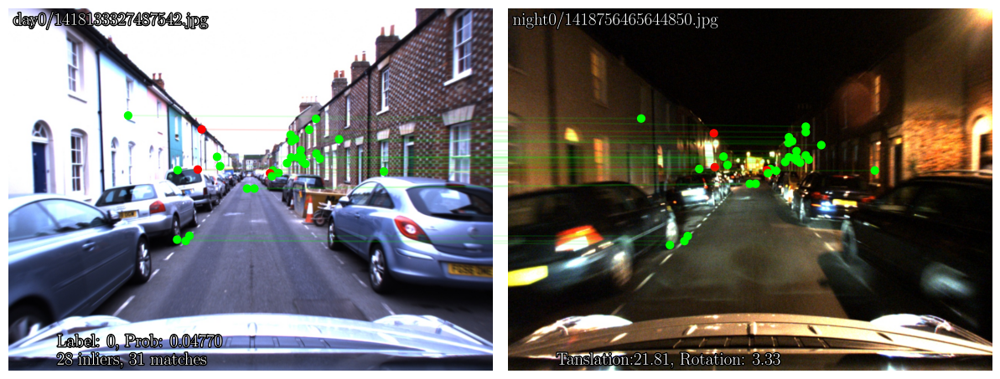

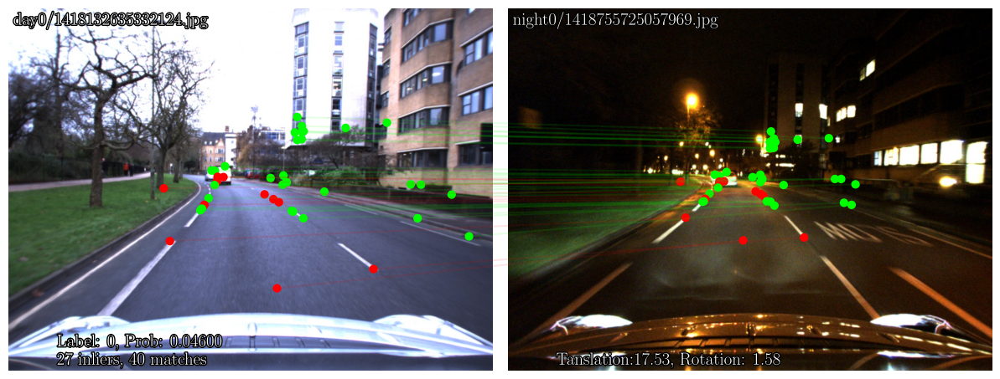

In [5]:
import numpy as np
from viz import plot_matches_pair
from pathlib import Path
from matplotlib import pyplot as plt

log = np.load('dataset/exps/night_superpoint_max_superglue_fn.npy', allow_pickle=True).tolist()
idx, qImages, rImages, probs, distances = log['idx'], log['qImages'], log['rImages'], log['probs'], log['distances']
match_path = Path('dataset/matches/night_superpoint_max_superglue.h5')
feature_path = Path('dataset/features/superpoint_max.h5')
database_image = Path('dataset/images/')
idx = np.random.choice(len(idx), 10, replace=False)
qImages = qImages[idx]
rImages = rImages[idx]
probs = probs[idx]


for qImage, rImage, prob, distance in zip(qImages, rImages, probs, distances):
      plot_matches_pair(match_path, feature_path, database_image, qImage, rImage, 0, prob, distance)
      plt.savefig(f'dataset/exps/night_fn_viz/{Path(qImage).stem}_{Path(rImage).stem}.png', bbox_inches='tight')
      plt.show()
      

(360, 640, 3)


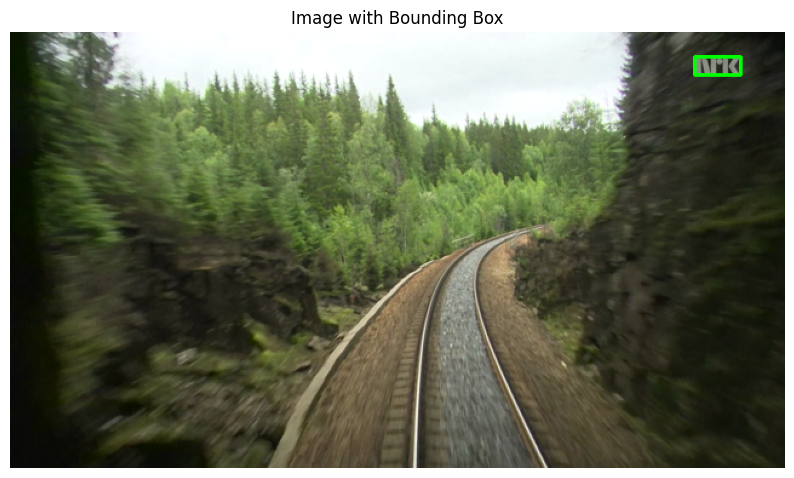

In [18]:
import cv2
import matplotlib.pyplot as plt

# Load an image using OpenCV
image_path = 'dataset/images/season2/image0000.png'
image = cv2.imread(image_path)
print(image.shape)

# Check if image is loaded properly
if image is None:
    print("Image not loaded properly.")
else:
    # Define the bounding box coordinates (x, y, width, height)
    # Example coordinates for demonstration
    x, y, w, h = 565, 20, 38, 15

    # Draw the rectangle on the image
    # The function cv2.rectangle modifies the image in place
    cv2.rectangle(image, (x, y), (x+w, y+h), (0, 255, 0), 2)  # Green box with thickness 2

    # Since OpenCV loads an image in BGR color space, convert it to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the image using Matplotlib
    plt.figure(figsize=(10, 6))
    plt.imshow(image_rgb)
    plt.axis('off')  # Turn off axis numbers and ticks
    plt.title('Image with Bounding Box')
    plt.show()